In [60]:
import plotly.graph_objects as go
import plotly.express as px
import pandas as pd


In [61]:
data = {
    'Date': pd.date_range(start='2023-01-01', periods=10, freq='D'),
    'Value': [20, 25, None, 30, None, 40, 35, 32, None, 28]
}

df = pd.DataFrame(data)


In [62]:
fig = go.Figure()

# Add the line trace
fig.add_trace(go.Scatter(
    x=df['Date'],
    y=df['Value'],
    mode='lines',
    name='Value'
))

# Add the scatter trace to highlight missing values
fig.add_trace(go.Scatter(
    x=df['Date'],
    y=df['Value'],
    mode='markers',
    marker=dict(
        color='red',  # You can change the color to your preference
        size=10,
        symbol='circle-cross',
        line=dict(
            color='black',
            width=1
        )
    ),
    name='Missing Values'
))

# Update layout for a better presentation
fig.update_layout(title='Line Plot with Highlighted Missing Values',
                  xaxis_title='Date',
                  yaxis_title='Value',
                  hovermode='x unified',  # Show hover info for both traces
                  showlegend=True)

# Show the plot
fig.show()


In [63]:
data = {
    'Date': pd.date_range(start='2023-01-01', periods=10, freq='D'),
    'Value': [20, 25, None, 30, None, 40, 35, 32, None, 28]
}

df = pd.DataFrame(data)


In [64]:
fig = go.Figure()

# Add the line trace
fig.add_trace(go.Scatter(
    x=df['Date'],
    y=df['Value'],
    mode='lines',
    name='Value'
))

# Find x-coordinates of regions with missing values
missing_indices = df[df['Value'].isnull()].index
x_values = df['Date'].iloc[missing_indices]

# Add ellipse shape to highlight missing value regions
fig.add_shape(
    type="circle",
    xref="x",
    yref="y",
    x0=min(x_values),
    y0=min(df['Value']),
    x1=max(x_values),
    y1=max(df['Value']),
    line=dict(
        color="red",  # You can change the color to your preference
        width=2,
    ),
)

# Update layout for a better presentation
fig.update_layout(title='Line Plot with Ellipse Highlighting Missing Value Region',
                  xaxis_title='Date',
                  yaxis_title='Value',
                  hovermode='x unified',  # Show hover info for both traces
                  showlegend=True)

# Show the plot
fig.show()


# 0. Reading the data
For work I used Google Colab and read data from the Google Drive, to use it on your PC, specify the path to the data.


In [2]:
import pandas as pd

In [1]:
# Mounting Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# Specifying location of the data
import os
os.chdir("/content/drive/MyDrive/Project/DadosPreprocessados")

In [4]:
# Read the data to the dataframes
df_datasources = pd.read_csv("datasources_p.csv")
df_series = pd.read_csv("series_p.csv")

In [5]:
df_seriesdata = pd.read_csv("seriesdata_p.csv", low_memory = False)

# 1.1. Data Sources understanding

In [6]:
df_datasources.head(5)

,datasourcetype_id,dataprovider_id,datasource_id,datasource_name,datasource_externalid,datasource_metadata,pob_station,dataprovider_name,datasourcetype_name,longitude,latitude
0,1,4,28,Iscarção,643,"{""Timezone"": ""Europe/Lisbon"", ""Daylight offset...",True,WiseCrop,Weather Station,"-9,03668","39,26951"
1,1,4,29,Vale da Fonte,697,"{""Timezone"": ""Europe/Lisbon"", ""Daylight offset...",True,WiseCrop,Weather Station,"-9,206385","39,274678"
2,1,4,31,Qta do Brejo,642,"{""Timezone"": ""Europe/Lisbon"", ""Daylight offset...",True,WiseCrop,Weather Station,"-9,064003","39,249927"
3,1,4,8,Quinta do Rato,717,"{""Timezone"": ""Europe/Lisbon"", ""Daylight offset...",True,WiseCrop,Weather Station,"-9,119531","39,478397"
4,1,1,16,COTHN,000004BB,"{""Timezone"": ""Europe/Lisbon"", ""Daylight offset...",False,PESSL,Weather Station,"-9,01499","39,28281"


Column 'datasource_metadata' contains dictionary-like data which can be break down to three separete columns:

In [7]:
# Convert column to dictionary
df_datasources['datasource_metadata'] = df_datasources['datasource_metadata'].apply(lambda x: eval(x))
# Create dataframe from the column and join to the initial dataframe
df_datasources = df_datasources.join(pd.DataFrame(df_datasources['datasource_metadata'].to_list()))
# Drop the old column
df_datasources = df_datasources.drop('datasource_metadata', axis=1)
# Rename columns
df_datasources = df_datasources.rename(columns={'Daylight offset': 'daylight_offset', 'Standard offset': 'standart_offset', 'Timezone': 'timezone'})

In [8]:
df_datasources.head(5)

,datasourcetype_id,dataprovider_id,datasource_id,datasource_name,datasource_externalid,pob_station,dataprovider_name,datasourcetype_name,longitude,latitude,timezone,daylight_offset,standart_offset
0,1,4,28,Iscarção,643,True,WiseCrop,Weather Station,"-9,03668","39,26951",Europe/Lisbon,1,0
1,1,4,29,Vale da Fonte,697,True,WiseCrop,Weather Station,"-9,206385","39,274678",Europe/Lisbon,1,0
2,1,4,31,Qta do Brejo,642,True,WiseCrop,Weather Station,"-9,064003","39,249927",Europe/Lisbon,1,0
3,1,4,8,Quinta do Rato,717,True,WiseCrop,Weather Station,"-9,119531","39,478397",Europe/Lisbon,1,0
4,1,1,16,COTHN,000004BB,False,PESSL,Weather Station,"-9,01499","39,28281",Europe/Lisbon,0,0


In [9]:
# Display the dataframe's info
df_datasources.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33 entries, 0 to 32
Data columns (total 13 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   datasourcetype_id      33 non-null     int64 
 1   dataprovider_id        33 non-null     int64 
 2   datasource_id          33 non-null     int64 
 3   datasource_name        33 non-null     object
 4   datasource_externalid  33 non-null     object
 5   pob_station            33 non-null     bool  
 6   dataprovider_name      33 non-null     object
 7   datasourcetype_name    33 non-null     object
 8   longitude              33 non-null     object
 9   latitude               33 non-null     object
 10  timezone               33 non-null     object
 11  daylight_offset        33 non-null     int64 
 12  standart_offset        33 non-null     int64 
dtypes: bool(1), int64(5), object(7)
memory usage: 3.3+ KB


The data frame doesn't have null values.

Latitude and longitude should be converted to float dtype.

In [10]:
# Count unique values in each column
df_datasources.apply(lambda x: len(x.unique()))

datasourcetype_id         1
dataprovider_id           4
datasource_id            33
datasource_name          33
datasource_externalid    33
pob_station               2
dataprovider_name         4
datasourcetype_name       1
longitude                33
latitude                 33
timezone                  1
daylight_offset           3
standart_offset           1
dtype: int64

We see that datasource_id, datasource_name and datasource_externalid are unique identifiers of the datasource.

All datasources share the same values of parameters: datasourcetype_id,
datasourcetype_name, timezone, standart_offset. Let's show the values of
these parameters and delete them from the data frame.

In [11]:
# Show values of datasourcetype_id, datasourcetype_name, timezone, standart_offset
df_datasources[['datasourcetype_id', 'datasourcetype_name', 'timezone', 'standart_offset']].iloc[0]

datasourcetype_id                    1
datasourcetype_name    Weather Station
timezone                 Europe/Lisbon
standart_offset                      0
Name: 0, dtype: object

In [12]:
# Drop datasourcetype_id, datasourcetype_name, timezone, standart_offset from the dataframe
df_datasources.drop(['datasourcetype_id', 'datasourcetype_name', 'timezone', 'standart_offset'], axis=1,inplace=True)

All data sources we have are weather statoins in Lisbon timezone with standart offset = 0

Let's convers latitude and longitude to the float dtype:

In [13]:
# Replace commas with periods
df_datasources.latitude = df_datasources.latitude.str.replace(',', '.')
df_datasources.longitude = df_datasources.longitude.str.replace(',', '.')
# Convert the string column to float
df_datasources.latitude = df_datasources.latitude.astype(float)
df_datasources.longitude = df_datasources.longitude.astype(float)

To look into destribution of stations among the parameters 'dataprovider_name','pob_station', 'daylight_offset', let's define a function which groupes data frame according to specified column, aggregate it by size() function amd plot a horizontal bar chart

In [14]:
import plotly.express as px
# Define a function
def plot_barh(df, column_name):
  grouped = df.groupby(column_name).size()
  fig = px.bar(y=grouped.index, x=grouped.values, orientation='h', text_auto=True)
  fig.update_layout(title='Count of Categories by ' + column_name,
                    xaxis_title='Count',
                    yaxis_title=column_name)
  fig.show()

In [15]:
# plot graphs
for column_name in ['dataprovider_name','pob_station', 'daylight_offset']:
  plot_barh(df_datasources, column_name)

To see geographical destribution of stations let's define a function which show our station on the map according to their latitude and londitude and color them according to selected property.

In [16]:
# Define the function
import plotly.express as px

def plot_map(df, column_name):
  fig = px.scatter_mapbox(df,
                          lat="latitude",
                          lon="longitude",
                          hover_name="datasource_name",
                          hover_data=["pob_station", "dataprovider_name", "daylight_offset"],
                          color = df[column_name],
                          zoom=7.5,
                          height=350)
  fig.update_layout(mapbox_style="open-street-map")
  fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
  fig.show()



In [17]:
# Plot maps
for column_name in ['dataprovider_name', 'pob_station', 'daylight_offset']:
  plot_map(df_datasources, column_name)
  print()

# 1.2. Series Understanding


In [18]:
df_series.head(5)

,seriesvariable_id,seriestype_id,series_id,datasource_id,seriestype_name,datatype_id,seriesperiod_id,calculationmethod_id,unit_symbol,seriesvariable_label,seriesvariable_longname,seriesvariable_standardname,seriesvariable_description
0,167,1,2105,16,Raw Series,37,3,1,°C,MEDPNTDP30M,Mean Dew Point Depression (30m),mean(dew_point_depression PT30M),Mean dew point depression in the last 30 minutes
1,60,1,205,16,Raw Series,2,7,3,°C,MXSOILTEMP3M,Maximum Soil Temperature (3m),max(soil_temperature PT3M),Maximum soil temperature in the last 3 minutes
2,21,1,475,6,Raw Series,6,4,5,min,ACCLFWET15M,Leaf Wetness Time (15m),accumulated(leaf_wetness PT15M),Accumulated time of leaf wetness in the last 1...
3,33,1,487,8,Raw Series,4,4,3,m/s,MXWNDSPD15M,Maximum Wind Speed (15m),max(wind_speed PT15M),Maximum wind speed in the last 15 minutes
4,81,1,489,8,Raw Series,7,4,1,kPa,MEVPD15M,Mean VPD (15m),mean(water_vapor_saturation_deficit PT15M),Mean VPD in the last 15 minutes


We can break down the column 'seriesvariable_standartname' to three separate columns: 'calculation_method', 'variable' and 'period':

In [19]:
# Some specific replacements to uniform the data
df_series['seriesvariable_standardname'] = df_series['seriesvariable_standardname'].str.replace('max(max(','max(', regex = False)
df_series['seriesvariable_standardname'] = df_series['seriesvariable_standardname'].str.replace('max_wind_speed(','max(', regex = False)
df_series['seriesvariable_standardname'] = df_series['seriesvariable_standardname'].str.replace('PT15m','PT15M', regex = False)

# Breack seriesveriable_standartname to three columns: calculation_method, datatype, period
df_series['seriesvariable_standardname'] = df_series['seriesvariable_standardname'].str.replace('(',' ', regex = False).str.replace(')', '', regex = False)
df_series[['calculation_method', 'variable', 'period']] = df_series['seriesvariable_standardname'].str.split(' ', n = 2, expand = True)

# Drop seriesvariable_longname column
df_series = df_series.drop('seriesvariable_longname', axis=1)

In [20]:
df_series.head(5)

,seriesvariable_id,seriestype_id,series_id,datasource_id,seriestype_name,datatype_id,seriesperiod_id,calculationmethod_id,unit_symbol,seriesvariable_label,seriesvariable_standardname,seriesvariable_description,calculation_method,variable,period
0,167,1,2105,16,Raw Series,37,3,1,°C,MEDPNTDP30M,mean dew_point_depression PT30M,Mean dew point depression in the last 30 minutes,mean,dew_point_depression,PT30M
1,60,1,205,16,Raw Series,2,7,3,°C,MXSOILTEMP3M,max soil_temperature PT3M,Maximum soil temperature in the last 3 minutes,max,soil_temperature,PT3M
2,21,1,475,6,Raw Series,6,4,5,min,ACCLFWET15M,accumulated leaf_wetness PT15M,Accumulated time of leaf wetness in the last 1...,accumulated,leaf_wetness,PT15M
3,33,1,487,8,Raw Series,4,4,3,m/s,MXWNDSPD15M,max wind_speed PT15M,Maximum wind speed in the last 15 minutes,max,wind_speed,PT15M
4,81,1,489,8,Raw Series,7,4,1,kPa,MEVPD15M,mean water_vapor_saturation_deficit PT15M,Mean VPD in the last 15 minutes,mean,water_vapor_saturation_deficit,PT15M


In [21]:
df_series.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 667 entries, 0 to 666
Data columns (total 15 columns):
 #   Column                       Non-Null Count  Dtype 
---  ------                       --------------  ----- 
 0   seriesvariable_id            667 non-null    int64 
 1   seriestype_id                667 non-null    int64 
 2   series_id                    667 non-null    int64 
 3   datasource_id                667 non-null    int64 
 4   seriestype_name              667 non-null    object
 5   datatype_id                  667 non-null    int64 
 6   seriesperiod_id              667 non-null    int64 
 7   calculationmethod_id         667 non-null    int64 
 8   unit_symbol                  667 non-null    object
 9   seriesvariable_label         667 non-null    object
 10  seriesvariable_standardname  667 non-null    object
 11  seriesvariable_description   610 non-null    object
 12  calculation_method           667 non-null    object
 13  variable                     667 no

In [22]:
df_series.apply(lambda x: len(x.unique()))

seriesvariable_id               74
seriestype_id                    1
series_id                      667
datasource_id                   59
seriestype_name                  1
datatype_id                     13
seriesperiod_id                  5
calculationmethod_id             5
unit_symbol                      9
seriesvariable_label            73
seriesvariable_standardname     73
seriesvariable_description      72
calculation_method               5
variable                        13
period                           5
dtype: int64

In [23]:
df_series.groupby(['variable','calculation_method']).size()

variable                        calculation_method
air_temperature                 max                   45
                                mean                  61
                                min                   45
dew_point_depression            mean                  40
dew_point_temperature           mean                  42
                                min                   12
leaf_wetness                    accumulated           34
precipitation_amount            sum                   42
reference_evapotranspiration    mean                   9
relative_humidity               max                    4
                                mean                  61
                                min                    4
soil_temperature                max                    3
                                mean                   3
                                min                    3
solar_irradiance                max                   14
                                mean 

<Axes: ylabel='variable,unit_symbol'>

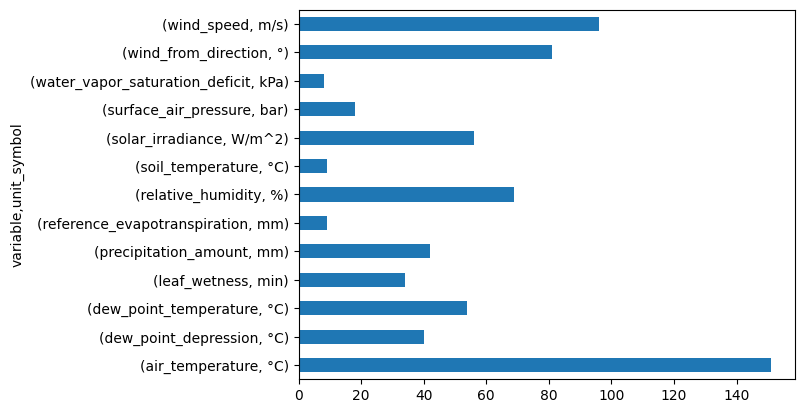

In [24]:
df_series.groupby(['variable','unit_symbol']).size().plot(kind='barh')
# Units are the same for the same type of measurments

In [25]:
# Change period value to timeinterval dtype (in minutes)

df_series['period'] = df_series['period'].str.replace('PT15M','15 minutes', regex = False).str.replace('PT3M','3 minutes', regex = False).str.replace('PT30M','30 minutes', regex = False).str.replace('PT1H','1 hour', regex = False).str.replace('PT1D','1 day', regex = False)
df_series['period'] = pd.to_timedelta(df_series['period'])

In [26]:
df_series

,seriesvariable_id,seriestype_id,series_id,datasource_id,seriestype_name,datatype_id,seriesperiod_id,calculationmethod_id,unit_symbol,seriesvariable_label,seriesvariable_standardname,seriesvariable_description,calculation_method,variable,period
0,167,1,2105,16,Raw Series,37,3,1,°C,MEDPNTDP30M,mean dew_point_depression PT30M,Mean dew point depression in the last 30 minutes,mean,dew_point_depression,0 days 00:30:00
1,60,1,205,16,Raw Series,2,7,3,°C,MXSOILTEMP3M,max soil_temperature PT3M,Maximum soil temperature in the last 3 minutes,max,soil_temperature,0 days 00:03:00
2,21,1,475,6,Raw Series,6,4,5,min,ACCLFWET15M,accumulated leaf_wetness PT15M,Accumulated time of leaf wetness in the last 1...,accumulated,leaf_wetness,0 days 00:15:00
3,33,1,487,8,Raw Series,4,4,3,m/s,MXWNDSPD15M,max wind_speed PT15M,Maximum wind speed in the last 15 minutes,max,wind_speed,0 days 00:15:00
4,81,1,489,8,Raw Series,7,4,1,kPa,MEVPD15M,mean water_vapor_saturation_deficit PT15M,Mean VPD in the last 15 minutes,mean,water_vapor_saturation_deficit,0 days 00:15:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
662,168,1,2136,22,Raw Series,37,4,1,°C,MEDPNTDP15M,mean dew_point_depression PT15M,Mean dew point depression in the last 15 minutes,mean,dew_point_depression,0 days 00:15:00
663,168,1,2137,11,Raw Series,37,4,1,°C,MEDPNTDP15M,mean dew_point_depression PT15M,Mean dew point depression in the last 15 minutes,mean,dew_point_depression,0 days 00:15:00
664,168,1,2138,12,Raw Series,37,4,1,°C,MEDPNTDP15M,mean dew_point_depression PT15M,Mean dew point depression in the last 15 minutes,mean,dew_point_depression,0 days 00:15:00
665,166,1,2139,36,Raw Series,37,2,1,°C,MEDPNTDP1H,mean dew_point_depression PT1H,Mean dew point depression in the last hour,mean,dew_point_depression,0 days 01:00:00


In [27]:
# Drop columns that doesn't give any information:
df_series.drop(['seriesvariable_description',
                'calculationmethod_id',
                'seriesperiod_id',
                'seriestype_name',
                'seriestype_id',
                'seriesvariable_label',
                'datatype_id',
                'seriesvariable_id'],axis=1,inplace=True)

In [28]:
df_series

,series_id,datasource_id,unit_symbol,seriesvariable_standardname,calculation_method,variable,period
0,2105,16,°C,mean dew_point_depression PT30M,mean,dew_point_depression,0 days 00:30:00
1,205,16,°C,max soil_temperature PT3M,max,soil_temperature,0 days 00:03:00
2,475,6,min,accumulated leaf_wetness PT15M,accumulated,leaf_wetness,0 days 00:15:00
3,487,8,m/s,max wind_speed PT15M,max,wind_speed,0 days 00:15:00
4,489,8,kPa,mean water_vapor_saturation_deficit PT15M,mean,water_vapor_saturation_deficit,0 days 00:15:00
...,...,...,...,...,...,...,...
662,2136,22,°C,mean dew_point_depression PT15M,mean,dew_point_depression,0 days 00:15:00
663,2137,11,°C,mean dew_point_depression PT15M,mean,dew_point_depression,0 days 00:15:00
664,2138,12,°C,mean dew_point_depression PT15M,mean,dew_point_depression,0 days 00:15:00
665,2139,36,°C,mean dew_point_depression PT1H,mean,dew_point_depression,0 days 01:00:00


In [29]:
df_series_and_sources = pd.merge(df_series, df_datasources, on='datasource_id')

In [30]:
df_series_and_sources

,series_id,datasource_id,unit_symbol,seriesvariable_standardname,calculation_method,variable,period,dataprovider_id,datasource_name,datasource_externalid,pob_station,dataprovider_name,longitude,latitude,daylight_offset
0,2105,16,°C,mean dew_point_depression PT30M,mean,dew_point_depression,0 days 00:30:00,1,COTHN,000004BB,False,PESSL,-9.01499,39.28281,0
1,205,16,°C,max soil_temperature PT3M,max,soil_temperature,0 days 00:03:00,1,COTHN,000004BB,False,PESSL,-9.01499,39.28281,0
2,175,16,°C,mean air_temperature PT30M,mean,air_temperature,0 days 00:30:00,1,COTHN,000004BB,False,PESSL,-9.01499,39.28281,0
3,177,16,°C,mean air_temperature PT3M,mean,air_temperature,0 days 00:03:00,1,COTHN,000004BB,False,PESSL,-9.01499,39.28281,0
4,178,16,°C,max air_temperature PT30M,max,air_temperature,0 days 00:30:00,1,COTHN,000004BB,False,PESSL,-9.01499,39.28281,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
469,555,34,%,mean relative_humidity PT30M,mean,relative_humidity,0 days 00:30:00,5,Silveira,9001,False,TerraPro,-9.33460,39.09316,-1
470,556,34,°,mean wind_from_direction PT30M,mean,wind_from_direction,0 days 00:30:00,5,Silveira,9001,False,TerraPro,-9.33460,39.09316,-1
471,557,34,min,accumulated leaf_wetness PT30M,accumulated,leaf_wetness,0 days 00:30:00,5,Silveira,9001,False,TerraPro,-9.33460,39.09316,-1
472,558,34,°C,mean dew_point_temperature PT30M,mean,dew_point_temperature,0 days 00:30:00,5,Silveira,9001,False,TerraPro,-9.33460,39.09316,-1


# Series Data Understanding


In [31]:
df_seriesdata

,datasource_externalid,series_id,datatype_id,seriesdata_timestamp,seriesdata_realvalue,Real Value
0,Coopval03VN,41,18,29/11/2020 00:00:00,NaN,NaN
1,Coopval03VN,41,18,12/01/2021 17:45:00,NaN,NaN
2,Coopval03VN,41,18,12/01/2021 18:00:00,NaN,NaN
3,Coopval03VN,41,18,28/11/2020 20:30:00,NaN,NaN
4,Coopval03VN,41,18,28/11/2020 20:45:00,NaN,NaN
...,...,...,...,...,...,...
9873960,CABValeC,129,1,14/10/2020 20:00:00,12.2,12.2
9873961,CABValeC,129,1,15/10/2020 20:00:00,12.2,12.2
9873962,CABValeC,129,1,16/10/2020 18:45:00,12.2,12.2
9873963,CABValeC,129,1,17/10/2020 20:30:00,12.2,12.2


In [32]:
df_seriesdata = df_seriesdata.rename(columns={'Real Value': 'value'}) # Rename columns
df_seriesdata.drop('seriesdata_realvalue',axis=1,inplace=True)

In [33]:
df_seriesdata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9873965 entries, 0 to 9873964
Data columns (total 5 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   datasource_externalid  object 
 1   series_id              int64  
 2   datatype_id            int64  
 3   seriesdata_timestamp   object 
 4   value                  float64
dtypes: float64(1), int64(2), object(2)
memory usage: 376.7+ MB


In [34]:
df_seriesdata.apply(lambda x: len(x.unique()))

datasource_externalid       11
series_id                  145
datatype_id                 13
seriesdata_timestamp     70332
value                    68400
dtype: int64

In [35]:
df_seriesdata.apply(lambda x: x.isnull().sum())

datasource_externalid         0
series_id                     0
datatype_id                   0
seriesdata_timestamp          0
value                    629669
dtype: int64

In [36]:
df_seriesdata.groupby('series_id')['value'].apply(lambda x: x.isnull().sum())

series_id
1       2421
2       2413
3       2413
4       2419
5       2747
        ... 
2126    3816
2127    3213
2132    3348
2133    3461
2134    3283
Name: value, Length: 145, dtype: int64

# II.


In [37]:
# Merge all together
df_data = pd.merge(df_seriesdata, df_series_and_sources, on='series_id')

In [38]:
df_data

,datasource_externalid_x,series_id,datatype_id,seriesdata_timestamp,value,datasource_id,unit_symbol,seriesvariable_standardname,calculation_method,variable,period,dataprovider_id,datasource_name,datasource_externalid_y,pob_station,dataprovider_name,longitude,latitude,daylight_offset
0,Coopval03VN,41,18,29/11/2020 00:00:00,NaN,3,bar,mean surface_air_pressure PT15M,mean,surface_air_pressure,0 days 00:15:00,2,Coopval03VN,Coopval03VN,False,APAS,-9.094394,39.203011,1
1,Coopval03VN,41,18,12/01/2021 17:45:00,NaN,3,bar,mean surface_air_pressure PT15M,mean,surface_air_pressure,0 days 00:15:00,2,Coopval03VN,Coopval03VN,False,APAS,-9.094394,39.203011,1
2,Coopval03VN,41,18,12/01/2021 18:00:00,NaN,3,bar,mean surface_air_pressure PT15M,mean,surface_air_pressure,0 days 00:15:00,2,Coopval03VN,Coopval03VN,False,APAS,-9.094394,39.203011,1
3,Coopval03VN,41,18,28/11/2020 20:30:00,NaN,3,bar,mean surface_air_pressure PT15M,mean,surface_air_pressure,0 days 00:15:00,2,Coopval03VN,Coopval03VN,False,APAS,-9.094394,39.203011,1
4,Coopval03VN,41,18,28/11/2020 20:45:00,NaN,3,bar,mean surface_air_pressure PT15M,mean,surface_air_pressure,0 days 00:15:00,2,Coopval03VN,Coopval03VN,False,APAS,-9.094394,39.203011,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9873960,CABValeC,140,9,04/08/2021 06:15:00,77.0,13,W/m^2,max solar_irradiance PT15M,max,solar_irradiance,0 days 00:15:00,2,CABValeC,CABValeC,False,APAS,-9.176588,39.244676,1
9873961,CABValeC,140,9,24/08/2021 07:45:00,77.0,13,W/m^2,max solar_irradiance PT15M,max,solar_irradiance,0 days 00:15:00,2,CABValeC,CABValeC,False,APAS,-9.176588,39.244676,1
9873962,CABValeC,140,9,01/09/2021 18:00:00,77.0,13,W/m^2,max solar_irradiance PT15M,max,solar_irradiance,0 days 00:15:00,2,CABValeC,CABValeC,False,APAS,-9.176588,39.244676,1
9873963,CABValeC,140,9,23/10/2021 17:15:00,77.0,13,W/m^2,max solar_irradiance PT15M,max,solar_irradiance,0 days 00:15:00,2,CABValeC,CABValeC,False,APAS,-9.176588,39.244676,1


In [39]:
df_data.apply(lambda x: x.isnull().sum())

datasource_externalid_x             0
series_id                           0
datatype_id                         0
seriesdata_timestamp                0
value                          629669
datasource_id                       0
unit_symbol                         0
seriesvariable_standardname         0
calculation_method                  0
variable                            0
period                              0
dataprovider_id                     0
datasource_name                     0
datasource_externalid_y             0
pob_station                         0
dataprovider_name                   0
longitude                           0
latitude                            0
daylight_offset                     0
dtype: int64

In [40]:
len(df_data)

9873965

In [41]:
df_data.drop_duplicates(subset=['series_id','seriesdata_timestamp'], inplace=True)

In [42]:
len(df_data)

9872809

In [43]:
df_data.apply(lambda x: len(x.unique()))

datasource_externalid_x           11
series_id                        145
datatype_id                       13
seriesdata_timestamp           70332
value                          68400
datasource_id                     11
unit_symbol                        9
seriesvariable_standardname       21
calculation_method                 5
variable                          13
period                             1
dataprovider_id                    3
datasource_name                   11
datasource_externalid_y           11
pob_station                        2
dataprovider_name                  3
longitude                         11
latitude                          11
daylight_offset                    2
dtype: int64

In [44]:
df_data.groupby(['datasource_id','variable','calculation_method'])['series_id'].apply(lambda x: len(x.unique()))

datasource_id  variable               calculation_method
1              air_temperature        max                   1
                                      mean                  1
                                      min                   1
               dew_point_depression   mean                  1
               dew_point_temperature  mean                  1
                                                           ..
30             relative_humidity      mean                  1
               solar_irradiance       mean                  1
               wind_from_direction    mean                  1
               wind_speed             max                   1
                                      mean                  1
Name: series_id, Length: 145, dtype: int64

In [45]:
df_data.groupby(['datasource_id','variable','calculation_method'])['series_id'].apply(lambda x: len(x.unique())).describe()

count    145.0
mean       1.0
std        0.0
min        1.0
25%        1.0
50%        1.0
75%        1.0
max        1.0
Name: series_id, dtype: float64

In [46]:
df_data.groupby('datasource_id')['series_id'].apply(lambda x: len(x.unique()))

datasource_id
1     15
2     15
3     15
9     11
13    15
14    15
15    15
16    14
28    10
29    10
30    10
Name: series_id, dtype: int64

In [47]:
plot_map(df_data[['latitude','longitude','dataprovider_name','datasource_name','datasource_id','pob_station','daylight_offset']].drop_duplicates(), 'dataprovider_name')

In [48]:
plot_map(df_data[['latitude','longitude','dataprovider_name','datasource_name','datasource_id','pob_station','daylight_offset']].drop_duplicates(), 'pob_station')

In [49]:
df_data

,datasource_externalid_x,series_id,datatype_id,seriesdata_timestamp,value,datasource_id,unit_symbol,seriesvariable_standardname,calculation_method,variable,period,dataprovider_id,datasource_name,datasource_externalid_y,pob_station,dataprovider_name,longitude,latitude,daylight_offset
0,Coopval03VN,41,18,29/11/2020 00:00:00,NaN,3,bar,mean surface_air_pressure PT15M,mean,surface_air_pressure,0 days 00:15:00,2,Coopval03VN,Coopval03VN,False,APAS,-9.094394,39.203011,1
1,Coopval03VN,41,18,12/01/2021 17:45:00,NaN,3,bar,mean surface_air_pressure PT15M,mean,surface_air_pressure,0 days 00:15:00,2,Coopval03VN,Coopval03VN,False,APAS,-9.094394,39.203011,1
2,Coopval03VN,41,18,12/01/2021 18:00:00,NaN,3,bar,mean surface_air_pressure PT15M,mean,surface_air_pressure,0 days 00:15:00,2,Coopval03VN,Coopval03VN,False,APAS,-9.094394,39.203011,1
3,Coopval03VN,41,18,28/11/2020 20:30:00,NaN,3,bar,mean surface_air_pressure PT15M,mean,surface_air_pressure,0 days 00:15:00,2,Coopval03VN,Coopval03VN,False,APAS,-9.094394,39.203011,1
4,Coopval03VN,41,18,28/11/2020 20:45:00,NaN,3,bar,mean surface_air_pressure PT15M,mean,surface_air_pressure,0 days 00:15:00,2,Coopval03VN,Coopval03VN,False,APAS,-9.094394,39.203011,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9873960,CABValeC,140,9,04/08/2021 06:15:00,77.0,13,W/m^2,max solar_irradiance PT15M,max,solar_irradiance,0 days 00:15:00,2,CABValeC,CABValeC,False,APAS,-9.176588,39.244676,1
9873961,CABValeC,140,9,24/08/2021 07:45:00,77.0,13,W/m^2,max solar_irradiance PT15M,max,solar_irradiance,0 days 00:15:00,2,CABValeC,CABValeC,False,APAS,-9.176588,39.244676,1
9873962,CABValeC,140,9,01/09/2021 18:00:00,77.0,13,W/m^2,max solar_irradiance PT15M,max,solar_irradiance,0 days 00:15:00,2,CABValeC,CABValeC,False,APAS,-9.176588,39.244676,1
9873963,CABValeC,140,9,23/10/2021 17:15:00,77.0,13,W/m^2,max solar_irradiance PT15M,max,solar_irradiance,0 days 00:15:00,2,CABValeC,CABValeC,False,APAS,-9.176588,39.244676,1


In [50]:
df_data.loc[(df_data['variable'] == 'air_temperature') & (df_data['calculation_method'] == 'mean')]

,datasource_externalid_x,series_id,datatype_id,seriesdata_timestamp,value,datasource_id,unit_symbol,seriesvariable_standardname,calculation_method,variable,period,dataprovider_id,datasource_name,datasource_externalid_y,pob_station,dataprovider_name,longitude,latitude,daylight_offset
343600,Coopval03VN,29,1,28/11/2021 15:30:00,12.4,3,°C,mean air_temperature PT15M,mean,air_temperature,0 days 00:15:00,2,Coopval03VN,Coopval03VN,False,APAS,-9.094394,39.203011,1
343601,Coopval03VN,29,1,28/11/2021 15:45:00,12.2,3,°C,mean air_temperature PT15M,mean,air_temperature,0 days 00:15:00,2,Coopval03VN,Coopval03VN,False,APAS,-9.094394,39.203011,1
343602,Coopval03VN,29,1,28/11/2021 16:00:00,12.1,3,°C,mean air_temperature PT15M,mean,air_temperature,0 days 00:15:00,2,Coopval03VN,Coopval03VN,False,APAS,-9.094394,39.203011,1
343603,Coopval03VN,29,1,28/11/2021 16:15:00,12.1,3,°C,mean air_temperature PT15M,mean,air_temperature,0 days 00:15:00,2,Coopval03VN,Coopval03VN,False,APAS,-9.094394,39.203011,1
343604,Coopval03VN,29,1,28/11/2021 16:30:00,11.9,3,°C,mean air_temperature PT15M,mean,air_temperature,0 days 00:15:00,2,Coopval03VN,Coopval03VN,False,APAS,-9.094394,39.203011,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9320367,CABValeC,127,1,01/08/2020 22:00:00,17.9,13,°C,mean air_temperature PT15M,mean,air_temperature,0 days 00:15:00,2,CABValeC,CABValeC,False,APAS,-9.176588,39.244676,1
9320368,CABValeC,127,1,01/08/2020 22:15:00,17.9,13,°C,mean air_temperature PT15M,mean,air_temperature,0 days 00:15:00,2,CABValeC,CABValeC,False,APAS,-9.176588,39.244676,1
9320369,CABValeC,127,1,01/08/2020 23:45:00,17.9,13,°C,mean air_temperature PT15M,mean,air_temperature,0 days 00:15:00,2,CABValeC,CABValeC,False,APAS,-9.176588,39.244676,1
9320370,CABValeC,127,1,02/08/2020 06:30:00,17.9,13,°C,mean air_temperature PT15M,mean,air_temperature,0 days 00:15:00,2,CABValeC,CABValeC,False,APAS,-9.176588,39.244676,1


In [51]:
def plot_series(df, variable, calculation_method, station, time_interval='all'):
  condition1 = df['variable'] == variable
  condition2 = df['calculation_method'] == calculation_method
  condition3 = df['datasource_id'] == station
  df = df.loc[condition1 & condition2 & condition3]
  df['seriesdata_timestamp'] = pd.to_datetime(df['seriesdata_timestamp'])
  df = df.set_index(df['seriesdata_timestamp'])
  df = df.sort_index()
  fig = px.line(df, x = df.index, y = 'value', width=1200)
  fig.update_traces(line=dict(width=0.5))
  fig.show()

In [52]:
plot_series(df_data, 'air_temperature', 'mean', 1)

<ipython-input-51-9440401c4c2c>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [59]:
station_name = 'CABAzamb'

grouped = df_data.groupby(['datasource_name', 'series_id'])
for name, group in grouped:
  if name[0] == station_name:
    group['seriesdata_timestamp'] = pd.to_datetime(group['seriesdata_timestamp'])
    group = group.set_index(group['seriesdata_timestamp'])
    group = group.sort_index()
    group.resample('1H').mean()
    fig = px.line(group, x = group.index, y = 'value', width=1200)
    fig.update_traces(line=dict(width=0.25))
    fig.update_layout(title=group['seriesvariable_standardname'][0],
                    xaxis_title='Time',
                    yaxis_title='value')
    fig.show()

<ipython-input-59-fce05a556436>:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



<ipython-input-59-fce05a556436>:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



<ipython-input-59-fce05a556436>:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



<ipython-input-59-fce05a556436>:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



<ipython-input-59-fce05a556436>:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



<ipython-input-59-fce05a556436>:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



<ipython-input-59-fce05a556436>:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



<ipython-input-59-fce05a556436>:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



<ipython-input-59-fce05a556436>:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



<ipython-input-59-fce05a556436>:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



<ipython-input-59-fce05a556436>:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



<ipython-input-59-fce05a556436>:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



<ipython-input-59-fce05a556436>:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



<ipython-input-59-fce05a556436>:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



<ipython-input-59-fce05a556436>:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



# II. Data Wrangling


In [ ]:
#2.1 Decide the format of your data.
# We use data in the long format

In [ ]:
#2.2 Add extra columns for simplifying understanding of the series variable, namely
#    by splitting the series variable standard name of the form
#    CALCULATION_METHOD(DATATYPE PERIOD) into its parts

#Breack seriesveriable_standartname to three columns: calculation_method, datatype, period#
df_series['seriesvariable_standardname'] = df_series['seriesvariable_standardname'].str.replace('(',' ', regex = False).str.replace(')', '', regex = False).str.replace('PT', '', regex=False)
df_series[['calculation_method', 'data_name', 'period']] = df_series['seriesvariable_standardname'].str.split(' ', n = 2, expand = True)

#Drop old columns with names
df_series = df_series.drop('seriesvariable_standardname', axis=1)
df_series = df_series.drop('seriesvariable_longname', axis=1)

## Merging dataframes:

In [ ]:
#Add information from df_series to the main dataframe#

df_seriesdata = pd.merge(df_seriesdata, df_series[['series_id','calculation_method', 'data_name','period', 'unit_symbol']], on = 'series_id')

In [ ]:
#Add information from df_datasources to the main datafraime#

df_seriesdata = pd.merge(df_seriesdata, df_datasources[['datasource_id', 'datasource_name', 'datasourcetype_name','longitude','latitude', 'datasource_externalid']], on = 'datasource_externalid', how = 'left')

In [ ]:
len(df_seriesdata)

9873965

In [ ]:
df_seriesdata = df_seriesdata.drop_duplicates(subset=['seriesdata_timestamp', 'series_id'])
len(df_seriesdata)

9872809

In [ ]:
df_seriesdata

,datasource_externalid,series_id,datatype_id,seriesdata_timestamp,seriesdata_realvalue,Real Value,calculation_method,data_name,period,unit_symbol,datasource_id,datasource_name,datasourcetype_name,longitude,latitude
0,Coopval03VN,41,18,29/11/2020 00:00:00,NaN,NaN,mean,surface_air_pressure,15M,bar,3,Coopval03VN,Weather Station,"-9,0943944","39,2030109"
1,Coopval03VN,41,18,12/01/2021 17:45:00,NaN,NaN,mean,surface_air_pressure,15M,bar,3,Coopval03VN,Weather Station,"-9,0943944","39,2030109"
2,Coopval03VN,41,18,12/01/2021 18:00:00,NaN,NaN,mean,surface_air_pressure,15M,bar,3,Coopval03VN,Weather Station,"-9,0943944","39,2030109"
3,Coopval03VN,41,18,28/11/2020 20:30:00,NaN,NaN,mean,surface_air_pressure,15M,bar,3,Coopval03VN,Weather Station,"-9,0943944","39,2030109"
4,Coopval03VN,41,18,28/11/2020 20:45:00,NaN,NaN,mean,surface_air_pressure,15M,bar,3,Coopval03VN,Weather Station,"-9,0943944","39,2030109"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9873960,CABValeC,140,9,04/08/2021 06:15:00,77.0,77.0,max,solar_irradiance,15M,W/m^2,13,CABValeC,Weather Station,"-9,1765881","39,2446761"
9873961,CABValeC,140,9,24/08/2021 07:45:00,77.0,77.0,max,solar_irradiance,15M,W/m^2,13,CABValeC,Weather Station,"-9,1765881","39,2446761"
9873962,CABValeC,140,9,01/09/2021 18:00:00,77.0,77.0,max,solar_irradiance,15M,W/m^2,13,CABValeC,Weather Station,"-9,1765881","39,2446761"
9873963,CABValeC,140,9,23/10/2021 17:15:00,77.0,77.0,max,solar_irradiance,15M,W/m^2,13,CABValeC,Weather Station,"-9,1765881","39,2446761"


In [ ]:
#2.3 Additionally, check If there are any duplicates, and try to understand why,
#    suggesting an appropriate duplicate removal strategy

#Drop duplicates, counting as duplicates rows with the same values of timestamp and series_id#
df_seriesdata = df_seriesdata.drop_duplicates(subset=['seriesdata_timestamp', 'series_id'])
df_seriesdata = df_seriesdata.drop_duplicates(subset=['seriesdata_timestamp', 'data_name', 'datasource_id', 'calculation_method'])

In [ ]:
#2.4 Perform an analysis of missing values in the way you find more convenient

#We can not merge series from unknown source or unknow id with other series, so we drop null values
df_seriesdata = df_seriesdata.dropna(subset = ['datasource_id', 'series_id'], how = 'any')

In [ ]:
#Analysis of missing values
df_seriesdata.groupby(['data_name', 'calculation_method'])['Real Value'].apply(lambda x: x.isnull().sum())

data_name                       calculation_method
air_temperature                 max                    15785
                                mean                   35160
                                min                    15785
dew_point_depression            mean                   45093
dew_point_temperature           mean                   42447
                                min                     4029
leaf_wetness                    accumulated            38497
precipitation_amount            sum                    30530
reference_evapotranspiration    mean                    9521
relative_humidity               mean                   35141
soil_temperature                max                     3386
                                mean                    3389
                                min                     3389
solar_irradiance                max                    11766
                                mean                   31021
surface_air_pressure            me

In [ ]:
df_seriesdata.groupby(['datasource_id'])['Real Value'].apply(lambda x: x.isnull().sum())

datasource_id
1     38757
2     45520
3     59445
9     47760
13    75995
14    76748
15    49126
16    57438
28    91346
29    27191
30    60081
Name: Real Value, dtype: int64

## Initial data processing

In [ ]:
#Sort dataframe by series_id and time#
df_seriesdata.sort_values(['series_id', 'seriesdata_timestamp'], inplace = True)

In [ ]:
#Describe values of datatypes to find anomaly values#
df_seriesdata[['data_name','calculation_method', 'Real Value']].groupby(['data_name','calculation_method']).describe()

Real Value               \
                                                       count         mean   
data_name                      calculation_method                           
air_temperature                max                  468751.0    15.550609   
                               mean                 717783.0    15.464575   
                               min                  468751.0    15.245184   
dew_point_depression           mean                 619534.0     6.296630   
dew_point_temperature          mean                 706187.0     9.419174   
                               min                   65657.0    12.516688   
leaf_wetness                   accumulated          714931.0     5.967456   
precipitation_amount           sum                  722898.0     0.017544   
reference_evapotranspiration   mean                     12.0     0.726454   
relative_humidity              mean                 717802.0    69.818660   
soil_temperature               max                   66785.0    17.287147   
                               mean                  66782.0    17.118658   
                               min                   66782.0    17.017036   
solar_irradiance               max                  403084.0   187.120588   
                               mean                 652236.0   164.357648   
surface_air_pressure           mean                 407010.0  1014.706467   
water_vapor_saturation_deficit mean                  46462.0     0.331360   
wind_from_direction            max_wind_speed       318548.0   170.192114   
                               mean                 567605.0   172.857153   
wind_speed                     max                  722899.0     2.559927   
                               mean                 722903.0     0.884591   

                                                                            \
                                                          std          min   
data_name                      calculation_method                            
air_temperature                max                   5.416750     -6.10000   
                               mean                  5.286861     -6.10000   
                               min                   5.371878    -67.80000   
dew_point_depression           mean                  4.120163     -0.05000   
dew_point_temperature          mean                  5.304612    -15.40000   
                               min                   4.468998     -7.30000   
leaf_wetness                   accumulated           6.944855     -1.00000   
precipitation_amount           sum                   0.173305      0.00000   
reference_evapotranspiration   mean                  0.245387      0.41888   
relative_humidity              mean                 17.628330      7.00000   
soil_temperature               max                   4.978207      2.60000   
                               mean                  4.966603      2.50000   
                               min                   4.956484      2.40000   
solar_irradiance               max                 511.385430 -32768.00000   
                               mean                422.271064 -32768.00000   
surface_air_pressure           mean                  7.728783    985.20000   
water_vapor_saturation_deficit mean                  0.447063      0.00000   
wind_from_direction            max_wind_speed      119.786400      0.00000   
                               mean                122.426149      0.00000   
wind_speed                     max                   2.331817      0.00000   
                               mean                  1.052460      0.00000   

                                                                           \
                                                          25%         50%   
data_name                      calculation_method                           
air_temperature                max                   12.30000    15.50000   
                    

In [ ]:
#Delete negetive values from Leaf Wetness and Sollar radiation#
df_seriesdata.loc[(df_seriesdata['data_name'] == 'leaf_wetness') & (df_seriesdata['Real Value'] < 0), 'Real Value'] = None
df_seriesdata.loc[(df_seriesdata['data_name'] == 'solar_irradiance') & (df_seriesdata['Real Value'] <= 0), 'Real Value'] = None
#Add 273 to temperature values to change to absolute temperature#
df_seriesdata.loc[df_seriesdata['data_name'].isin(['soil_temperature', 'dew_point_temperature', 'air_temperature']), 'Real Value'] += 273

In [ ]:
# Our dataframe after initial processing
df_seriesdata

,datasource_externalid,series_id,datatype_id,seriesdata_timestamp,seriesdata_realvalue,Real Value,calculation_method,data_name,period,unit_symbol,datasource_id,datasource_name,datasourcetype_name,longitude,latitude
2084050,CABAzamb,1,1,01/01/2020 00:00:00,7.4,280.4,mean,air_temperature,15M,°C,1,CABAzamb,Weather Station,"-9,1868985","39,2814793"
2083567,CABAzamb,1,1,01/01/2020 00:15:00,6.6,279.6,mean,air_temperature,15M,°C,1,CABAzamb,Weather Station,"-9,1868985","39,2814793"
2083240,CABAzamb,1,1,01/01/2020 00:30:00,5.7,278.7,mean,air_temperature,15M,°C,1,CABAzamb,Weather Station,"-9,1868985","39,2814793"
2083847,CABAzamb,1,1,01/01/2020 00:45:00,7.1,280.1,mean,air_temperature,15M,°C,1,CABAzamb,Weather Station,"-9,1868985","39,2814793"
2083848,CABAzamb,1,1,01/01/2020 01:00:00,7.1,280.1,mean,air_temperature,15M,°C,1,CABAzamb,Weather Station,"-9,1868985","39,2814793"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7580779,CPFQuint,2134,37,31/12/2021 22:45:00,15.5,15.5,mean,dew_point_depression,15m,°C,15,CPFQuint,Weather Station,"-9,1889048","39,325982"
7580780,CPFQuint,2134,37,31/12/2021 23:00:00,15.4,15.4,mean,dew_point_depression,15m,°C,15,CPFQuint,Weather Station,"-9,1889048","39,325982"
7580781,CPFQuint,2134,37,31/12/2021 23:15:00,15.4,15.4,mean,dew_point_depression,15m,°C,15,CPFQuint,Weather Station,"-9,1889048","39,325982"
7580782,CPFQuint,2134,37,31/12/2021 23:30:00,15.4,15.4,mean,dew_point_depression,15m,°C,15,CPFQuint,Weather Station,"-9,1889048","39,325982"


In [ ]:
# 2.5 Define a function that allows you to plot easily the minimum, mean, maximum
#     values in period in a given time span

#Function for plotting series by series_id, agregated and resampled
def plot_series(df, series_id, aggregations, resample_period):
  grouped = df.groupby('series_id')
  for id in series_id:
    group = grouped.get_group(id)
    group['seriesdata_timestamp'] = pd.to_datetime(group['seriesdata_timestamp'])
    group.set_index('seriesdata_timestamp', inplace=True)
    group['Real Value'].resample(resample_period).agg(aggregations).plot(title=(group['calculation_method'][0] + ' ' + group['data_name'][0]))

<ipython-input-16-947bfcc56c32>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group['seriesdata_timestamp'] = pd.to_datetime(group['seriesdata_timestamp'])
<ipython-input-16-947bfcc56c32>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  group['seriesdata_timestamp'] = pd.to_datetime(group['seriesdata_timestamp'])


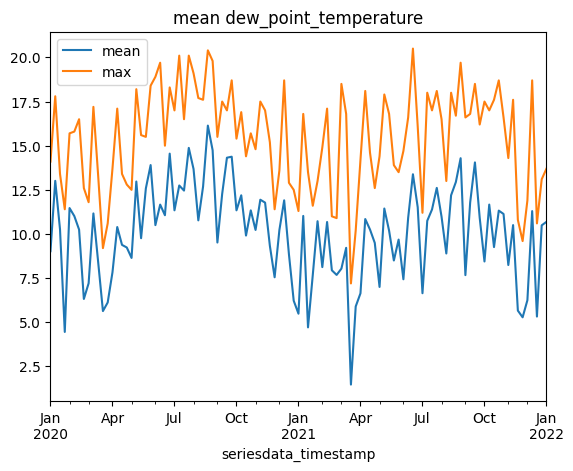

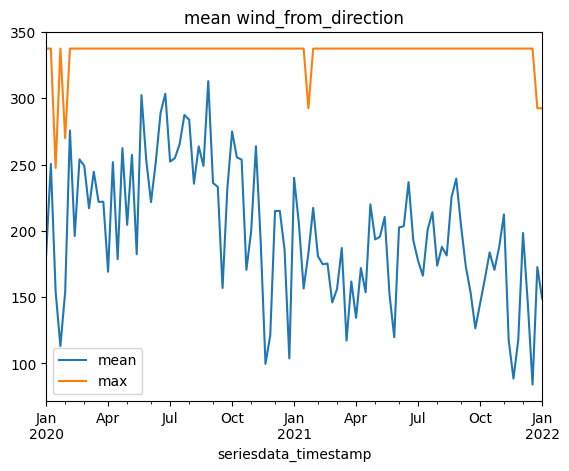

In [ ]:
#Plotting series
plot_series(df_seriesdata, [5, 11], ['mean', 'max'], '1W')

In [ ]:
# Transforming seriesdata_timestamp to datetime dtype (takes ~18m)
df_seriesdata['seriesdata_timestamp'] = pd.to_datetime(df_seriesdata['seriesdata_timestamp'])

In [ ]:
df_1 = df_seriesdata.copy()
df_2 = df_seriesdata.copy()

# III. Data Agregation

In [ ]:
# Check number of recordings for each recording type
df_1.groupby(['data_name','calculation_method'])['Real Value'].count()

data_name                       calculation_method
air_temperature                 max                   468751
                                mean                  717783
                                min                   468751
dew_point_depression            mean                  619534
dew_point_temperature           mean                  706187
                                min                    65657
leaf_wetness                    accumulated           714899
precipitation_amount            sum                   722898
reference_evapotranspiration    mean                      12
relative_humidity               mean                  717802
soil_temperature                max                    66785
                                mean                   66782
                                min                    66782
solar_irradiance                max                   205503
                                mean                  333177
surface_air_pressure            me

In [ ]:
# Describe variables:
df_1[['data_name','calculation_method', 'Real Value']].groupby(['data_name','calculation_method']).describe()

Real Value               \
                                                       count         mean   
data_name                      calculation_method                           
air_temperature                max                  468751.0   288.550609   
                               mean                 717783.0   288.464575   
                               min                  468751.0   288.245184   
dew_point_depression           mean                 619534.0     6.296630   
dew_point_temperature          mean                 706187.0   282.419174   
                               min                   65657.0   285.516688   
leaf_wetness                   accumulated          714899.0     5.967767   
precipitation_amount           sum                  722898.0     0.017544   
reference_evapotranspiration   mean                     12.0     0.726454   
relative_humidity              mean                 717802.0    69.818660   
soil_temperature               max                   66785.0   290.287147   
                               mean                  66782.0   290.118658   
                               min                   66782.0   290.017036   
solar_irradiance               max                  205503.0   377.392228   
                               mean                 333177.0   328.143585   
surface_air_pressure           mean                 407010.0  1014.706467   
water_vapor_saturation_deficit mean                  46462.0     0.331360   
wind_from_direction            max_wind_speed       318548.0   170.192114   
                               mean                 567605.0   172.857153   
wind_speed                     max                  722899.0     2.559927   
                               mean                 722903.0     0.884591   

                                                                          \
                                                          std        min   
data_name                      calculation_method                          
air_temperature                max                   5.416750  266.90000   
                               mean                  5.286861  266.90000   
                               min                   5.371878  205.20000   
dew_point_depression           mean                  4.120163   -0.05000   
dew_point_temperature          mean                  5.304612  257.60000   
                               min                   4.468998  265.70000   
leaf_wetness                   accumulated           6.944854    0.00000   
precipitation_amount           sum                   0.173305    0.00000   
reference_evapotranspiration   mean                  0.245387    0.41888   
relative_humidity              mean                 17.628330    7.00000   
soil_temperature               max                   4.978207  275.60000   
                               mean                  4.966603  275.50000   
                               min                   4.956484  275.40000   
solar_irradiance               max                 315.563397    5.00000   
                               mean                291.197035    1.00000   
surface_air_pressure           mean                  7.728783  985.20000   
water_vapor_saturation_deficit mean                  0.447063    0.00000   
wind_from_direction            max_wind_speed      119.786400    0.00000   
                               mean                122.426149    0.00000   
wind_speed                     max                   2.331817    0.00000   
                               mean                  1.052460    0.00000   

                                                                           \
                                                          25%         50%   
data_name                      calculation_method                           
air_temperature                max                  285.30000   288.50000   
                               mean                 285.30000   288.

In [ ]:
#Dropping mesurment types with small number of recordings
df_1 = df_1[df_1['calculation_method'].isin(['mean', 'accumulated', 'sum'])]
df_1 = df_1[~df_1['data_name'].isin(['soil_temperature', 'water_vapor_saturation_deficit', 'wind_from_direction', 'reference_evapotranspiration' ])]

In [ ]:
# Pivotting table to wide format, there for each datasource and time point there are values for all mesurments
df_1 = df_1.pivot(index=['datasource_id','seriesdata_timestamp'],columns='data_name', values = 'Real Value')

In [ ]:
# Dataframe
df_1

data_name                           air_temperature  dew_point_depression  \
datasource_id seriesdata_timestamp                                          
1             2020-01-01 00:00:00            280.40                  2.00   
              2020-01-01 00:15:00            279.60                  2.50   
              2020-01-01 00:30:00            278.70                  2.20   
              2020-01-01 00:45:00            280.10                  1.90   
              2020-01-01 01:00:00            280.10                  2.10   
...                                             ...                   ...   
30            2021-12-27 14:45:00            290.87                  4.37   
              2021-12-27 15:00:00            290.83                  4.33   
              2021-12-27 15:15:00            290.49                  4.29   
              2021-12-27 15:30:00            290.88                  4.18   
              2021-12-27 15:45:00            290.58                  4.18   

data_name                           dew_point_temperature  leaf_wetness  \
datasource_id seriesdata_timestamp                                        
1             2020-01-01 00:00:00                   278.4          14.0   
              2020-01-01 00:15:00                   277.1          14.0   
              2020-01-01 00:30:00                   276.5           NaN   
              2020-01-01 00:45:00                   278.2           NaN   
              2020-01-01 01:00:00                   278.0           NaN   
...                                                   ...           ...   
30            2021-12-27 14:45:00                   286.5           0.0   
              2021-12-27 15:00:00                   286.5           0.0   
              2021-12-27 15:15:00                   286.2           0.0   
              2021-12-27 15:30:00                   286.7           0.0   
              2021-12-27 15:45:00                   286.4           0.0   

data_name                           precipitation_amount  relative_humidity  \
datasource_id seriesdata_timestamp                                            
1             2020-01-01 00:00:00                    0.0              87.00   
              2020-01-01 00:15:00                    0.0              84.00   
              2020-01-01 00:30:00                    0.0              86.00   
              2020-01-01 00:45:00                    0.0              88.00   
              2020-01-01 01:00:00                    0.0              87.00   
...                                                  ...                ...   
30            2021-12-27 14:45:00                    0.0              75.42   
              2021-12-27 15:00:00                    0.0              75.70   
              2021-12-27 15:15:00                    0.0              75.85   
              2021-12-27 15:30:00                    0.0              76.21   
              2021-12-27 15:45:00                    0.0              76.34   

data_name                           solar_irradiance  surface_air_pressure  \
datasource_id seriesdata_timestamp                                           
1             2020-01-01 00:00:00                NaN                1022.7   
              2020-01-01 00:15:00                NaN                1022.7   
              2020-01-01 00:30:00                NaN                1022.8   
              2020-01-01 00:45:00                NaN                1022.5   
              2020-01-01 01:00:00                NaN                1022.5   
...                                              ...                   ...   
30            2021-12-27 14:45:00             394.61                   NaN   
              2021-12-27 15:00:00             186.16                   NaN   
              2021-12-27 15:15:00             185.33                   NaN   
              2021-12-27 15:30:00             143.37                   NaN   
              2021-12-27 15:45:00             125.66      

In [ ]:
# Creating groups by datasource_id
grouped = df_1.groupby('datasource_id')

In [ ]:
#3.1 Filling missing information using interpolation methods
#3.2 Aggregate the previous data hourly;
#3.3 If there are missing values at the hourly value, you can employ the same or
#    other interpolation methods to construct a new derived series

#  Break big dataframe to different dataframes by station id, interpolating and aggregating values by hour
#  and unite them again
df = pd.DataFrame()
for name, group in grouped:
  group = group.reset_index(level='datasource_id', drop=False) # Dropping datasource_id from index and creating a column with it
  group = group.interpolate(limit=94)   # Interpolating missing values with max limit of gap = 94 (one day)
  group = group.resample('1H').agg({'air_temperature':'mean', 'dew_point_depression':'mean',
                                   'dew_point_temperature': 'mean', 'leaf_wetness': 'sum', 'precipitation_amount':'sum',
                                   'relative_humidity': 'mean', 'wind_speed':'mean', 'solar_irradiance':'mean',
                                    'datasource_id': 'first'}).interpolate(method='akima')  # Resampling by hour and interpolating missing values
  group = group.dropna(how='any')  # Dropping None values
  group = group.reset_index('seriesdata_timestamp', drop=False)
  group = group.set_index(['datasource_id','seriesdata_timestamp'])
  if not group.empty:
    df = pd.concat([df,group], ignore_index=False)

In [ ]:
# Resulting dataframe
df

data_name                           air_temperature  dew_point_depression  \
datasource_id seriesdata_timestamp                                          
1.0           2020-01-01 10:00:00        287.152273              6.390152   
              2020-01-01 11:00:00        287.650000              6.775000   
              2020-01-01 12:00:00        287.450000              6.675000   
              2020-01-01 13:00:00        286.012500              5.572917   
              2020-01-01 14:00:00        285.075000              4.920833   
...                                             ...                   ...   
30.0          2021-12-27 11:00:00        290.767500              3.317500   
              2021-12-27 12:00:00        291.091667              3.966667   
              2021-12-27 13:00:00        291.103333              4.278333   
              2021-12-27 14:00:00        291.145000              4.495000   
              2021-12-27 15:00:00        290.695000              4.245000   

data_name                           dew_point_temperature  leaf_wetness  \
datasource_id seriesdata_timestamp                                        
1.0           2020-01-01 10:00:00              280.762121     52.500000   
              2020-01-01 11:00:00              280.875000     50.961538   
              2020-01-01 12:00:00              280.775000     49.423077   
              2020-01-01 13:00:00              280.439583     47.884615   
              2020-01-01 14:00:00              280.154167     46.346154   
...                                                   ...           ...   
30.0          2021-12-27 11:00:00              287.450000      0.000000   
              2021-12-27 12:00:00              287.125000      0.000000   
              2021-12-27 13:00:00              286.825000      0.000000   
              2021-12-27 14:00:00              286.650000      0.000000   
              2021-12-27 15:00:00              286.450000      0.000000   

data_name                           precipitation_amount  relative_humidity  \
datasource_id seriesdata_timestamp                                            
1.0           2020-01-01 10:00:00                    0.0          65.424242   
              2020-01-01 11:00:00                    0.0          63.750000   
              2020-01-01 12:00:00                    0.0          64.250000   
              2020-01-01 13:00:00                    0.0          68.885417   
              2020-01-01 14:00:00                    0.0          71.895833   
...                                                  ...                ...   
30.0          2021-12-27 11:00:00                    0.0          80.555000   
              2021-12-27 12:00:00                    0.0          77.287500   
              2021-12-27 13:00:00                    0.0          75.795000   
              2021-12-27 14:00:00                    0.0          74.735000   
              2021-12-27 15:00:00                    0.0          76.025000   

data_name                           wind_speed  solar_irradiance  
datasource_id seriesdata_timestamp                                
1.0           2020-01-01 10:00:00     0.875000        416.666667  
              2020-01-01 11:00:00     0.775000        320.000000  
              2020-01-01 12:00:00     0.400000        137.750000  
              2020-01-01 13:00:00     1.000000         33.750000  
              2020-01-01 14:00:00     0.000000         17.560811  
...                                        ...               ...  
30.0          2021-12-27 11:00:00     2.050000        392.375000  
              2021-12-27 12:00:00     2.616667        231.620833  
              2021-12-27 13:00:00     2.008333        391.241667  
              2021-12-27 14:00:00     3.925000        379.130000  
              2021-12-27 15:00:00     3.200000        160.130000  

[175155 rows x 8 columns]

In [ ]:
#3.4 Characterize daily each of your series with the number of missing values

# Check if there are missing values
df.isnull().any(axis=1).sum()

0

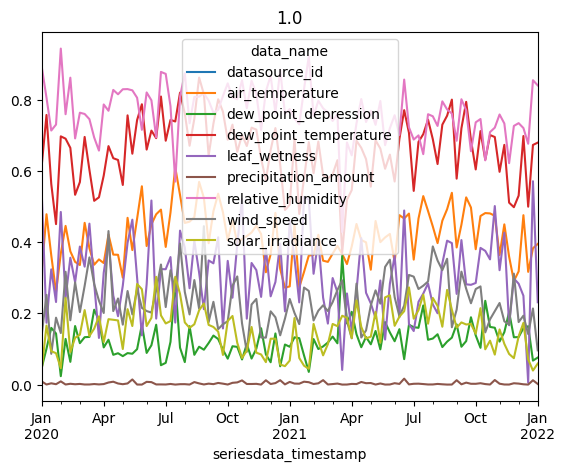

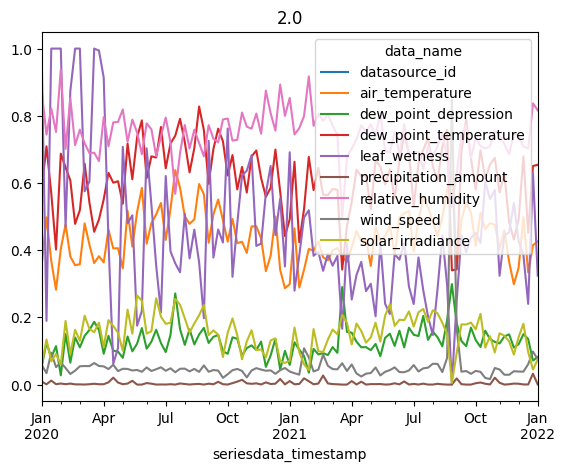

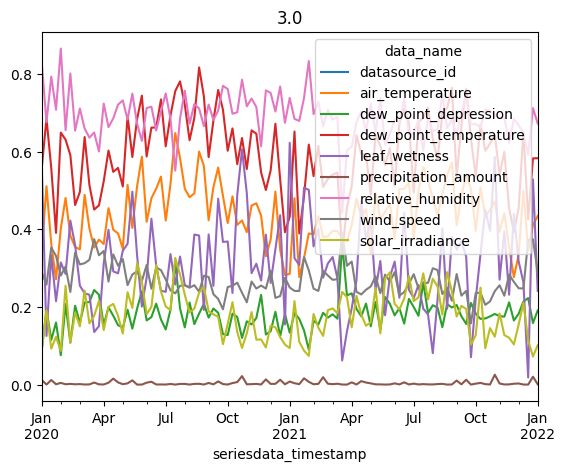

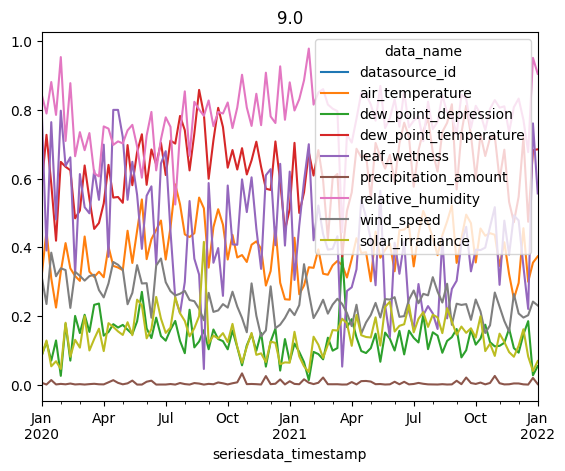

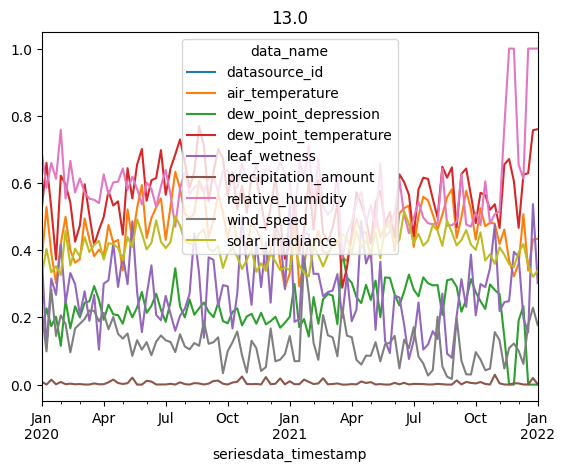

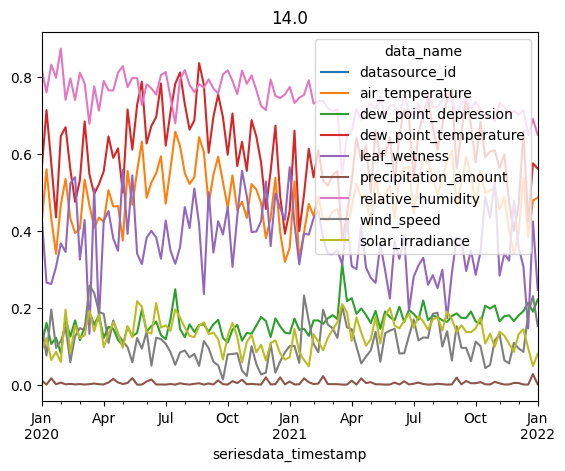

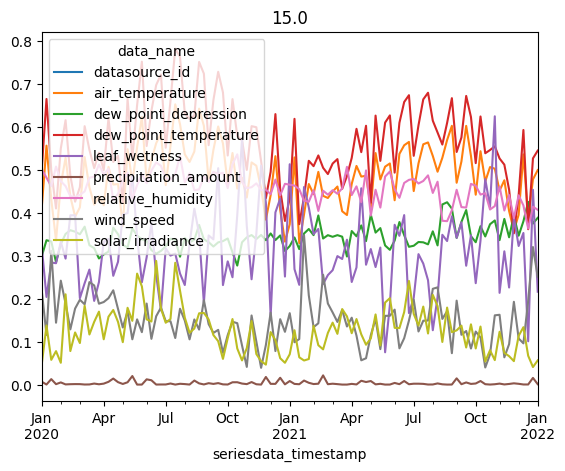

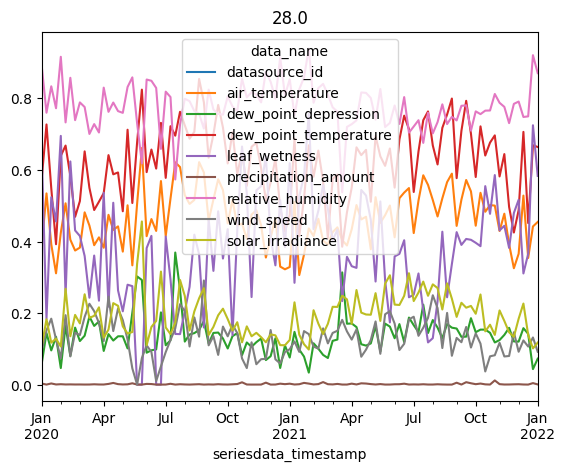

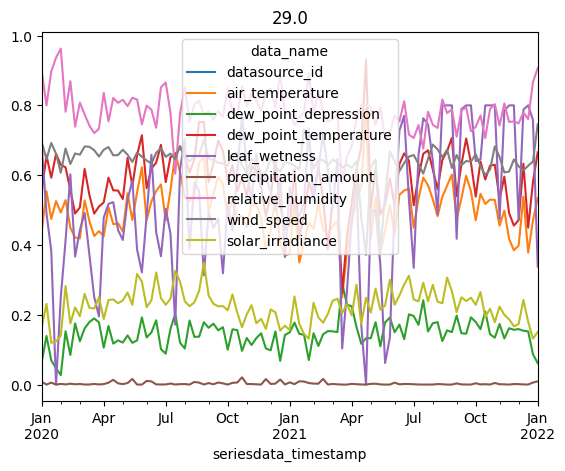

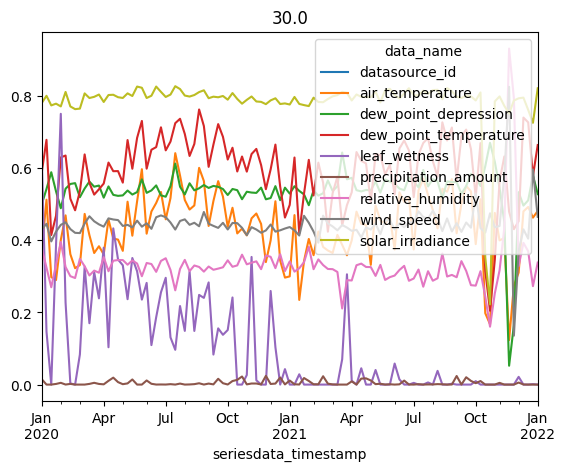

In [ ]:
#Ploting resampled measurments by each station
normalize = True
resample_period = '1W'

grouped = df.groupby('datasource_id')
for name, group in grouped:
  group = group.reset_index('datasource_id')
  if normalize:
    group = (group - group.min()) / (group.max() - group.min())
  group.resample(resample_period).mean().plot(title=str(name))

In [ ]:
#Check correlation between variables by station
station_id = 1
grouped = df.groupby('datasource_id')
group = grouped.get_group(station_id)
group.corr()

data_name,air_temperature,dew_point_depression,dew_point_temperature,leaf_wetness,precipitation_amount,relative_humidity,wind_speed,solar_irradiance
data_name,,,,,,,,
air_temperature,1.000000,0.430520,0.715066,-0.247940,-0.052121,-0.362982,0.264398,0.589390
dew_point_depression,0.430520,1.000000,-0.309444,-0.488903,-0.098510,-0.961238,0.208765,0.508966
dew_point_temperature,0.715066,-0.309444,1.000000,0.124684,0.022752,0.378481,0.111379,0.219928
leaf_wetness,-0.247940,-0.488903,0.124684,1.000000,0.168501,0.551006,-0.253998,-0.424804
precipitation_amount,-0.052121,-0.098510,0.022752,0.168501,1.000000,0.111738,0.011110,-0.072458
relative_humidity,-0.362982,-0.961238,0.378481,0.551006,0.111738,1.000000,-0.234966,-0.506648
wind_speed,0.264398,0.208765,0.111379,-0.253998,0.011110,-0.234966,1.000000,0.400224
solar_irradiance,0.589390,0.508966,0.219928,-0.424804,-0.072458,-0.506648,0.400224,1.000000


# IV. Data Understanding

In [ ]:
# We have 11 stations

station_nbr = len(df_seriesdata['datasource_externalid'].unique())
print(station_nbr)

station_l = df_2['datasource_id'].unique()
print(station_l)

11
[ 1  2  3 13 14 15 16  9 28 29 30]


In [ ]:
# We have 13 parameters, we have to collect summary about parameters 1, 3, 4, 6, and 8 for correlation analysis

matrix = df_2[['datatype_id', 'data_name']]
clean_matrix = matrix.drop_duplicates(subset=['datatype_id', 'data_name'])
sorted_matrix = clean_matrix.sort_values('datatype_id').reset_index(drop=True)
sorted_matrix

,datatype_id,data_name
0,1,air_temperature
1,2,soil_temperature
2,3,precipitation_amount
3,4,wind_speed
4,5,dew_point_temperature
5,6,leaf_wetness
6,7,water_vapor_saturation_deficit
7,8,relative_humidity
8,9,solar_irradiance
9,12,reference_evapotranspiration


In [ ]:
# Function for aggregating data by series in which the parameter was measured, where n=datatype_id, m=datasource_id, k=series_id

def station_data_aggregation_series(df, n, m):
  df_station_n = df[df['datatype_id'] == n].copy()
  df_station_nm = df_station_n[df_station_n['datasource_id'] == m].copy()
  series = list(df_station_nm['series_id'].unique())
  df_series_list = []
  if len(series) == 0:
    return df_series_list
  elif len(series) == 1:
    df_station_nmk = df_station_nm[df_station_nm['series_id'] == int(series[0])].copy()
    df_station_nmk.set_index('seriesdata_timestamp', inplace=True)
    df_station_nmk['seriesdata_realvalue'] = df_station_nmk['seriesdata_realvalue'].interpolate(method='linear', limit = 96)
    df_station_nmk = df_station_nmk.drop('Real Value', axis=1)
    df_station_nmk.dropna(inplace=True)
    df_series_list.append(df_station_nmk)
  else:
    for k in range(len(series)):
      df_station_nmk = df_station_nm[df_station_nm['series_id'] == int(series[k])].copy()
      df_station_nmk.set_index('seriesdata_timestamp', inplace=True)
      df_station_nmk['seriesdata_realvalue'] = df_station_nmk['seriesdata_realvalue'].interpolate(method='linear', limit = 96)
      df_station_nmk = df_station_nmk.drop('Real Value', axis=1)
      df_station_nmk.dropna(inplace=True)
      df_series_list.append(df_station_nmk)

  return df_series_list

In [ ]:
# Function for aggregating data by measured parameter, where n=datatype_id

def station_data_aggregation_global(df, n):
    df_copy = df[df['datatype_id'] == n].copy()
    df_copy.set_index('seriesdata_timestamp', inplace=True)
    df_copy['seriesdata_realvalue'] = df_copy['seriesdata_realvalue'].interpolate(method='linear', limit = 96)
    df_copy = df_copy.drop('Real Value', axis=1)
    df_copy.dropna(inplace=True)

    return df_copy

In [ ]:
# 4.1 Perform the analysis globally and for each individual station, for the major weather variables
# Firstly, we collect data for each measured parameter (the data is presented as a list of df)

param_list = [1, 2, 3, 4, 5, 6, 7, 8, 9, 12, 18, 24, 37]
df_interpolated_list = []

for param in param_list:
    df_interpolated = station_data_aggregation_global(df_seriesdata, param)
    df_interpolated_list.append(df_interpolated)

In [ ]:
# Thus, when accessing the list by parameter index, we get summary information on the values ​​of a particular parameter for all stations

df_interpolated_list[3]

,datasource_externalid,series_id,datatype_id,seriesdata_realvalue,calculation_method,data_name,period,unit_symbol,datasource_id,datasource_name,datasourcetype_name,longitude,latitude
seriesdata_timestamp,,,,,,,,,,,,,
30/04/2021 18:30:00,Coopval03VN,35,4,0.0,max,wind_speed,15M,m/s,3,Coopval03VN,Weather Station,"-9,0943944","39,2030109"
30/04/2021 18:45:00,Coopval03VN,35,4,0.0,max,wind_speed,15M,m/s,3,Coopval03VN,Weather Station,"-9,0943944","39,2030109"
30/04/2021 19:00:00,Coopval03VN,35,4,0.0,max,wind_speed,15M,m/s,3,Coopval03VN,Weather Station,"-9,0943944","39,2030109"
30/04/2021 19:15:00,Coopval03VN,35,4,0.0,max,wind_speed,15M,m/s,3,Coopval03VN,Weather Station,"-9,0943944","39,2030109"
30/04/2021 19:30:00,Coopval03VN,35,4,0.0,max,wind_speed,15M,m/s,3,Coopval03VN,Weather Station,"-9,0943944","39,2030109"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
23/01/2021 12:30:00,CABValeC,132,4,4.5,mean,wind_speed,15M,m/s,13,CABValeC,Weather Station,"-9,1765881","39,2446761"
23/01/2021 12:45:00,CABValeC,132,4,4.5,mean,wind_speed,15M,m/s,13,CABValeC,Weather Station,"-9,1765881","39,2446761"
23/01/2021 14:30:00,CABValeC,132,4,4.5,mean,wind_speed,15M,m/s,13,CABValeC,Weather Station,"-9,1765881","39,2446761"


In [ ]:
# leaf_wetness by station

stations_id_l = list(df_interpolated_list[5]['series_id'].unique())
s = []
df_stations_list = []

for i in range(len(stations_id_l)):
  df = df_interpolated_list[5][df_interpolated_list[5]['series_id'] == int(stations_id_l[i])].copy()
  df_stations_list.append(df)

In [ ]:
# leaf_wetness by station, 11 stations

df_stations_list[7]

,datasource_externalid,series_id,datatype_id,seriesdata_realvalue,calculation_method,data_name,period,unit_symbol,datasource_id,datasource_name,datasourcetype_name,longitude,latitude
seriesdata_timestamp,,,,,,,,,,,,,
04/02/2020 12:15:00,000004BB,185,6,0.0,accumulated,leaf_wetness,15M,min,16,COTHN,Weather Station,"-9,01499","39,28281"
04/02/2020 12:30:00,000004BB,185,6,0.0,accumulated,leaf_wetness,15M,min,16,COTHN,Weather Station,"-9,01499","39,28281"
04/02/2020 12:45:00,000004BB,185,6,0.0,accumulated,leaf_wetness,15M,min,16,COTHN,Weather Station,"-9,01499","39,28281"
04/02/2020 13:00:00,000004BB,185,6,0.0,accumulated,leaf_wetness,15M,min,16,COTHN,Weather Station,"-9,01499","39,28281"
04/02/2020 13:15:00,000004BB,185,6,0.0,accumulated,leaf_wetness,15M,min,16,COTHN,Weather Station,"-9,01499","39,28281"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
23/12/2021 16:15:00,000004BB,185,6,0.0,accumulated,leaf_wetness,15M,min,16,COTHN,Weather Station,"-9,01499","39,28281"
23/12/2021 16:30:00,000004BB,185,6,0.0,accumulated,leaf_wetness,15M,min,16,COTHN,Weather Station,"-9,01499","39,28281"
23/12/2021 16:45:00,000004BB,185,6,0.0,accumulated,leaf_wetness,15M,min,16,COTHN,Weather Station,"-9,01499","39,28281"


In [ ]:
# Temperature by station

st_id_l = list(df_interpolated_list[0]['series_id'].unique())
s = []
df_stations_list_temp = []

for i in range(len(st_id_l)):
  df = df_interpolated_list[0][df_interpolated_list[0]['series_id'] == int(st_id_l[i])].copy()
  df_stations_list_temp.append(df)

In [ ]:
# Temperature by station, 11 stations

df_stations_list_temp[5]

,datasource_externalid,series_id,datatype_id,seriesdata_realvalue,calculation_method,data_name,period,unit_symbol,datasource_id,datasource_name,datasourcetype_name,longitude,latitude
seriesdata_timestamp,,,,,,,,,,,,,
2020-01-01 00:00:00,Coopval01VV,17,1,3.8,min,air_temperature,15M,°C,2,Coopval01VV,Weather Station,"-9,0422469","39,2485189"
2020-01-01 00:15:00,Coopval01VV,17,1,3.7,min,air_temperature,15M,°C,2,Coopval01VV,Weather Station,"-9,0422469","39,2485189"
2020-01-01 00:30:00,Coopval01VV,17,1,3.7,min,air_temperature,15M,°C,2,Coopval01VV,Weather Station,"-9,0422469","39,2485189"
2020-01-01 00:45:00,Coopval01VV,17,1,3.7,min,air_temperature,15M,°C,2,Coopval01VV,Weather Station,"-9,0422469","39,2485189"
2020-01-01 01:00:00,Coopval01VV,17,1,3.7,min,air_temperature,15M,°C,2,Coopval01VV,Weather Station,"-9,0422469","39,2485189"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-12-31 22:45:00,Coopval01VV,17,1,13.4,min,air_temperature,15M,°C,2,Coopval01VV,Weather Station,"-9,0422469","39,2485189"
2021-12-31 23:00:00,Coopval01VV,17,1,13.3,min,air_temperature,15M,°C,2,Coopval01VV,Weather Station,"-9,0422469","39,2485189"
2021-12-31 23:15:00,Coopval01VV,17,1,13.3,min,air_temperature,15M,°C,2,Coopval01VV,Weather Station,"-9,0422469","39,2485189"


In [ ]:
# By using function for aggregating data by series in which the parameter was measured we can make a
# a three-dimensional array, in which the first argument is the station, the second is the measured parameter,
# the third is the measurement series of a specific parameter
#
# Such a format of data aggregation will allow measuring the correlations between all the parameters of interest
# of all stations in a cycle, taking into account the fact that the same type of measurement at the selected station
# could be carried out in different time intervals (different series)

stations_l = [3, 9, 1, 2, 30, 29, 28, 16, 15, 14, 13]
datatype_l = [1, 2, 3, 4, 5, 7, 8, 9, 12, 18, 24, 37]

df_interpolated_list = []
stations = []

for station in stations_l:
  for datatype in datatype_l:
    df_interpolated = station_data_aggregation_series(df_seriesdata, datatype, station)
    df_interpolated_list.append(df_interpolated)
  stations.append(df_interpolated_list)

In [ ]:
# Example of the above logic
# station 3, param - relative_humidity, series_id - 32

stations[1][6][0]

,datasource_externalid,series_id,datatype_id,seriesdata_realvalue,calculation_method,data_name,period,unit_symbol,datasource_id,datasource_name,datasourcetype_name,longitude,latitude
seriesdata_timestamp,,,,,,,,,,,,,
31/08/2020 13:45:00,Coopval03VN,32,8,13.0,mean,relative_humidity,15M,%,3,Coopval03VN,Weather Station,"-9,0943944","39,2030109"
03/09/2020 13:00:00,Coopval03VN,32,8,13.0,mean,relative_humidity,15M,%,3,Coopval03VN,Weather Station,"-9,0943944","39,2030109"
31/08/2020 12:15:00,Coopval03VN,32,8,14.0,mean,relative_humidity,15M,%,3,Coopval03VN,Weather Station,"-9,0943944","39,2030109"
08/09/2020 15:15:00,Coopval03VN,32,8,14.0,mean,relative_humidity,15M,%,3,Coopval03VN,Weather Station,"-9,0943944","39,2030109"
18/03/2021 13:30:00,Coopval03VN,32,8,14.0,mean,relative_humidity,15M,%,3,Coopval03VN,Weather Station,"-9,0943944","39,2030109"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
01/01/2020 09:30:00,Coopval03VN,32,8,79.0,mean,relative_humidity,15M,%,3,Coopval03VN,Weather Station,"-9,0943944","39,2030109"
01/01/2020 09:45:00,Coopval03VN,32,8,79.0,mean,relative_humidity,15M,%,3,Coopval03VN,Weather Station,"-9,0943944","39,2030109"
01/01/2020 10:00:00,Coopval03VN,32,8,79.0,mean,relative_humidity,15M,%,3,Coopval03VN,Weather Station,"-9,0943944","39,2030109"


In [ ]:
# 4.2 Perform correlation analysis among the several weather stations and major weather variables
# Correlation analysis among the several weather stations and major weather variables (leaf_wetness and humidity)

stations_l = [3,9,1,2,30,29,28,16,15,14,13]

for i in range(len(stations_l)):
  correlation = df_stations_list[i]['seriesdata_realvalue'].corr(stations[i][6][0]['seriesdata_realvalue'])
  print('correlation between leaf_wetness and humidity for station', stations_l[i], 'is', correlation)

correlation between leaf_wetness and humidity for station 3 is 0.4913694495175732
correlation between leaf_wetness and humidity for station 9 is 0.5237419796556781
correlation between leaf_wetness and humidity for station 1 is 0.49698611494549555
correlation between leaf_wetness and humidity for station 2 is 0.5596686549840709
correlation between leaf_wetness and humidity for station 30 is 0.48431455712002874
correlation between leaf_wetness and humidity for station 29 is 0.527715606708717
correlation between leaf_wetness and humidity for station 28 is 0.4611814383120871
correlation between leaf_wetness and humidity for station 16 is 0.5529185214322965
correlation between leaf_wetness and humidity for station 15 is 0.5403347209437619
correlation between leaf_wetness and humidity for station 14 is 0.4553280318853192
correlation between leaf_wetness and humidity for station 13 is 0.270794552718453


In [ ]:
# 4.2 Perform correlation analysis among the several weather stations and major weather variables (temperature and humidity)
# Correlation analysis among the several weather stations and major weather variables (temperature and humidity)

for i in range(11):
  correlation = df_stations_list_temp[i]['seriesdata_realvalue'].corr(stations[i][7][0]['seriesdata_realvalue'])
  print('correlation between temperature and humidity for station', stations_l[i], 'is', correlation)

correlation between temperature and humidity for station 3 is 0.5497015617183845
correlation between temperature and humidity for station 9 is 0.5520814251167989
correlation between temperature and humidity for station 1 is 0.5343039477005822
correlation between temperature and humidity for station 2 is 0.5885752650657113
correlation between temperature and humidity for station 30 is 0.5873553294697278
correlation between temperature and humidity for station 29 is 0.5760003204341521
correlation between temperature and humidity for station 28 is 0.6265207302213261
correlation between temperature and humidity for station 16 is 0.6220642663227418
correlation between temperature and humidity for station 15 is 0.610934121812692
correlation between temperature and humidity for station 14 is 0.573050256076774
correlation between temperature and humidity for station 13 is 0.5723985731911166


In [ ]:
# There is no different series at one station for temperature and leaf_wetness, below is the check
# Check for leaf_wetness

n = 0
for i in range(len(df_stations_list)):
  series = list(df_stations_list[i]['series_id'].unique())
  if len(series) == 1:
    continue
  else:
    n+=1
if n == 0:
  print('OK')
else:
  print('NOT OK')

OK


In [ ]:
# There is no different series at one station for temperature and leaf_wetness, below is the check
# Check for temperature

n = 0
for i in range(len(df_stations_list_temp)):
  series = list(df_stations_list_temp[i]['series_id'].unique())
  if len(series) == 1:
    continue
  else:
    n+=1
if n == 0:
  print('OK')
else:
  print('NOT OK')

OK


In [ ]:
# Correlation analysis among the several weather stations and major weather variables (temperature, relative humidity, wind speed, precipitation, and leaf wetness)
# There is no different series at one station for temperature and leaf_wetness

stations_l = [3,9,1,2,30,29,28,16,15,14,13]

for i in range(11):
  temperature = df_stations_list_temp[i]['seriesdata_realvalue']
  t_name = df_stations_list_temp[i]['data_name'][0]
  relative_humidity = stations[i][6][0]['seriesdata_realvalue']
  h_name = stations[i][6][0]['data_name'][0]
  wind_speed = stations[i][3][0]['seriesdata_realvalue']
  w_name = stations[i][3][0]['data_name'][0]
  precipitation = stations[i][2][0]['seriesdata_realvalue']
  p_name = stations[i][2][0]['data_name'][0]
  leaf_wetness = df_stations_list[i]['seriesdata_realvalue']
  l_name = df_stations_list[i]['data_name'][0]

  params = [temperature, relative_humidity, wind_speed, precipitation, leaf_wetness]
  params_names = [t_name, h_name, w_name, p_name, l_name]
  print('Station №', stations_l[i])

  j = 0
  k = 0
  while j+1 < len(params):
    while k+1 < len(params):
      correlation = params[j].corr(params[k+1])
      print('correlation between ', params_names[j], 'and ', params_names[k+1], 'is', correlation)
      k+=1
    k=0
    j+=1

Station № 3
correlation between  air_temperature and  relative_humidity is -0.46706456368025284
correlation between  air_temperature and  wind_speed is 0.03769458149562674
correlation between  air_temperature and  precipitation_amount is -0.030507978032294717
correlation between  air_temperature and  leaf_wetness is -0.29265801212843506
correlation between  relative_humidity and  relative_humidity is 1.0
correlation between  relative_humidity and  wind_speed is -0.4059255522930336
correlation between  relative_humidity and  precipitation_amount is 0.07406003016686803
correlation between  relative_humidity and  leaf_wetness is 0.4913694495175732
correlation between  wind_speed and  relative_humidity is -0.4059255522930336
correlation between  wind_speed and  wind_speed is 0.9999999999999999
correlation between  wind_speed and  precipitation_amount is 0.045158719793386606
correlation between  wind_speed and  leaf_wetness is -0.18735507730231016
correlation between  precipitation_amount a

# V. Calculating Leaf Wetness

In [ ]:
!pip install umap-learn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 kB 6.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 45.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82816 sha256=c4d3e02887e77864fe13951a42366259188589a255830b2abdded1b0bbab4cf2
  Stored in directory: /root/.cache/pip/wheels/a0/e8/c6/a37ea663620bd5200ea1ba0907ab3c217042c1d035ef606acc
  Created wheel for pynndescent: filename=pynndescent-0.5.10-py3-none-any.whl size=55622 sha256=97b72747c413dd4a430edf54a3ec1a384b419b52865b1182b406afe3eb706d70
  Stored in directory: /root/.cache/pip/wheels/4a/38/5d/f60a40a66a9512b7e5e83517ebc2d1b42d857be97d135f1096
Successfully built umap-learn pynndescent


In [ ]:
import umap
from sklearn.preprocessing import MinMaxScaler

In [ ]:
#5.1 Perform UMAP (or t-SNE) dimension reduction for the data, trying to determine
#    if data is separable regarding the cases where leaf wetness = 0 versus leaf wetness > 0
#    green - leaf_wetness == 0, red - leaf_wetness == 60, blue - 0 < leaf_wetness < 60

# Plotting UMAP by station_id
def plot_umap_by_station(df, station_ids):
  for station_id in station_ids:
    grouped = df.groupby('datasource_id')
    group = grouped.get_group(station_id)

    scaler = MinMaxScaler()
    normalized_data = scaler.fit_transform(group.drop('leaf_wetness',axis=1))

    umap_obj = umap.UMAP()
    umap_embedding = umap_obj.fit_transform(normalized_data)

    colors = ['green' if val == 0 else 'red' if val == 60 else 'blue' for val in group['leaf_wetness']]
    figure = plt.figure()
    plt.scatter(umap_embedding[:, 0], umap_embedding[:, 1], s=0.05, c=colors)
    plt.title("UMAP Visualization, station: " + str(station_id))
    plt.show()

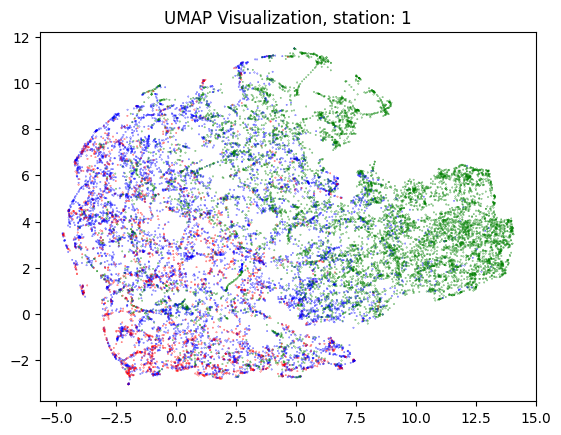

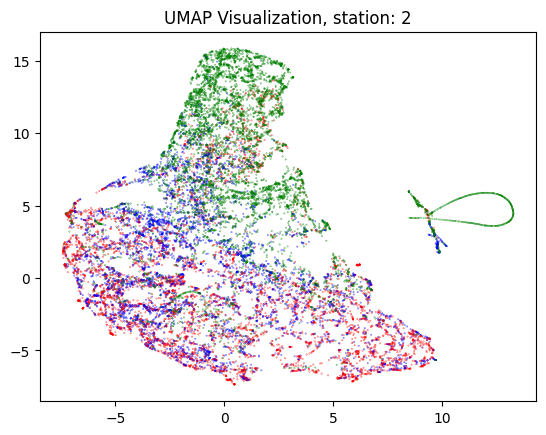

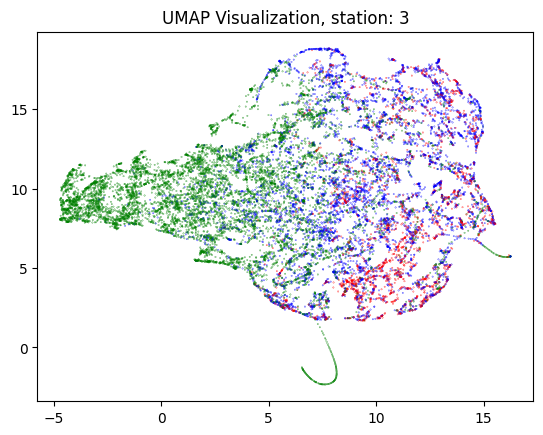

In [ ]:
plot_umap_by_station(df, [1, 2, 3])

In [ ]:
# Put leaf_wetness on the first place
column_to_move = df['leaf_wetness']
df = df.drop(columns='leaf_wetness')
df.insert(0, 'leaf_wetness', column_to_move)

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score

In [ ]:
# Simple Linear Regression without previous classification
def build_regression(df, station_ids):
  for station_id in station_ids:
    grouped = df.groupby('datasource_id')
    group = grouped.get_group(station_id)

    scaler = MinMaxScaler()
    data_norm = scaler.fit_transform(group)

    X_train, X_test, y_train, y_test = train_test_split(data_norm[:, 1:], data_norm[:, 0], test_size=0.2, random_state=42)

    regression_model = LinearRegression()
    regression_model.fit(X_train, y_train)
    y_pred = regression_model.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)

    r2 = r2_score(y_test, y_pred)
    print("For station ", station_id, "r2=" + str(r2))

In [ ]:
build_regression(df, df.reset_index('datasource_id', drop=False)['datasource_id'].unique())

For station  1.0 r2=0.3839553707036678
For station  2.0 r2=0.3754647975620594
For station  3.0 r2=0.39445384561559715
For station  9.0 r2=0.3679510499952344
For station  13.0 r2=0.2866470403607182
For station  14.0 r2=0.40754932547544864
For station  15.0 r2=0.2833966781923044
For station  28.0 r2=0.5515022167665036
For station  29.0 r2=0.1723773339037381
For station  30.0 r2=0.08040710964610687


In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

In [ ]:
#Decision tree to classify leaf_wetness == 0 and leaf_wetness > 0

def build_decision_tree(df, stations_ids):
  for station_id in stations_ids:
    grouped = df.groupby('datasource_id')
    group = grouped.get_group(station_id)

    X = group.drop('leaf_wetness', axis=1)
    y = group['leaf_wetness'].apply(lambda x: 1 if x > 0 else 0)

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Create and fit the decision tree classifier
    clf = DecisionTreeClassifier()
    clf.fit(X_train, y_train)

    y_pred = clf.predict(X_test)

    # Calculate accuracy
    accuracy = accuracy_score(y_test, y_pred)
    print("Accuracy for station", str(station_id) + ': ' + str(accuracy))

In [ ]:
build_decision_tree(df, df.reset_index('datasource_id', drop=False)['datasource_id'].unique())

Accuracy for station 1.0: 0.8061020815511833
Accuracy for station 2.0: 0.8027366020524516
Accuracy for station 3.0: 0.8167046750285063
Accuracy for station 9.0: 0.7690992018244014
Accuracy for station 13.0: 0.8189851767388826
Accuracy for station 14.0: 0.8420302252637581
Accuracy for station 15.0: 0.8039327443716159
Accuracy for station 28.0: 0.8811288483466363
Accuracy for station 29.0: 0.7898052691867125
Accuracy for station 30.0: 0.8273980470993682


In [ ]:
df.reset_index(inplace=True)

In [ ]:
df

data_name,datasource_id,seriesdata_timestamp,leaf_wetness,air_temperature,dew_point_depression,dew_point_temperature,precipitation_amount,relative_humidity,wind_speed,solar_irradiance
0,1.0,2020-01-01 10:00:00,52.500000,287.152273,6.390152,280.762121,0.0,65.424242,0.875000,416.666667
1,1.0,2020-01-01 11:00:00,50.961538,287.650000,6.775000,280.875000,0.0,63.750000,0.775000,320.000000
2,1.0,2020-01-01 12:00:00,49.423077,287.450000,6.675000,280.775000,0.0,64.250000,0.400000,137.750000
3,1.0,2020-01-01 13:00:00,47.884615,286.012500,5.572917,280.439583,0.0,68.885417,1.000000,33.750000
4,1.0,2020-01-01 14:00:00,46.346154,285.075000,4.920833,280.154167,0.0,71.895833,0.000000,17.560811
...,...,...,...,...,...,...,...,...,...,...
175150,30.0,2021-12-27 11:00:00,0.000000,290.767500,3.317500,287.450000,0.0,80.555000,2.050000,392.375000
175151,30.0,2021-12-27 12:00:00,0.000000,291.091667,3.966667,287.125000,0.0,77.287500,2.616667,231.620833
175152,30.0,2021-12-27 13:00:00,0.000000,291.103333,4.278333,286.825000,0.0,75.795000,2.008333,391.241667
175153,30.0,2021-12-27 14:00:00,0.000000,291.145000,4.495000,286.650000,0.0,74.735000,3.925000,379.130000


In [ ]:
df.drop(['datasource_id', 'seriesdata_timestamp'], axis=1, inplace=True)

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report


scaler = MinMaxScaler()
data_norm = scaler.fit_transform(df)

X_train, X_test, y_train, y_test = train_test_split(data_norm[:, 1:], data_norm[:, 0], test_size=0.2, random_state=42)


classifier = LogisticRegression()
classifier.fit(X_train, np.digitize(y_train, [0, 1]))


category_predictions = classifier.predict(X_test)


category_0_indices = np.where(category_predictions == 1)
category_60_indices = np.where(category_predictions == 3)
category_0_values = np.zeros_like(y_test)
category_60_values = np.ones_like(y_test)


regression_indices = np.where(category_predictions == 2)
regression_X = X_test[regression_indices]
regression_y = y_test[regression_indices]

regression_model = LinearRegression()
regression_model.fit(regression_X, regression_y)
regression_predictions = regression_model.predict(regression_X)


predictions = np.zeros_like(y_test)
predictions[category_0_indices] = category_0_values[category_0_indices]
predictions[regression_indices] = regression_predictions
predictions[category_60_indices] = category_60_values[category_60_indices]


classification_report = classification_report(np.digitize(y_test, [0, 1]), category_predictions)
print("Classification Report:\n", classification_report)



ValueError: ignored